<span style="font-size: 40px;">HW4-2 Enhanced DQN Variants (epochs = 3000)</span>

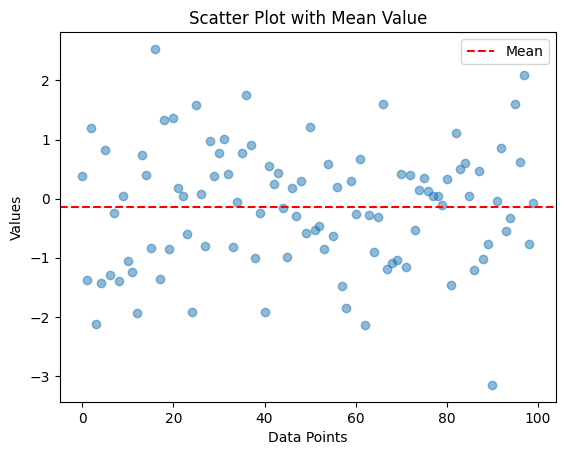

In [1]:
import matplotlib.pyplot as plt
import numpy as np

# Generate sample data
data = np.random.randn(100)

# Calculate the mean value
mean_value = np.mean(data)

# Plot the data with alpha level
plt.scatter(range(len(data)), data, alpha=0.5)

# Add a horizontal line for the mean value
plt.axhline(mean_value, color='red', linestyle='--', label='Mean')

# Set plot properties
plt.xlabel('Data Points')
plt.ylabel('Values')
plt.title('Scatter Plot with Mean Value')
plt.legend()

# Display the plot
plt.show()

In [2]:
from Gridworld import Gridworld
game = Gridworld(size=4, mode='static')

In [3]:
#使用GPU
import torch
print(torch.__version__)
print(torch.cuda.is_available())  # 如果是 GPU 版應該會顯示 True

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

2.7.0+cu118
True
Using device: cuda


In [4]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from Gridworld import Gridworld
from IPython.display import clear_output
import random
from matplotlib import pylab as plt

L1 = 64 #輸入層的寬度
L2 = 150 #第一隱藏層的寬度
L3 = 100 #第二隱藏層的寬度
L4 = 4 #輸出層的寬度

model = torch.nn.Sequential(
    torch.nn.Linear(L1, L2), #第一隱藏層的shape 
    torch.nn.ReLU(),
    torch.nn.Linear(L2, L3), #第二隱藏層的shape
    torch.nn.ReLU(),
    torch.nn.Linear(L3,L4) #輸出層的shape
).to(device)
loss_fn = torch.nn.MSELoss() #指定損失函數為MSE（均方誤差）
learning_rate = 1e-3  #設定學習率
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate) #指定優化器為Adam，其中model.parameters會傳回所有要優化的權重參數

gamma = 0.9 #折扣因子
epsilon = 1.0

In [5]:
action_set = {
	0: 'u', #『0』代表『向上』
	1: 'd', #『1』代表『向下』
	2: 'l', #『2』代表『向左』
	3: 'r' #『3』代表『向右』
}

In [6]:
def test_model(model, mode='static', display=True):
    i = 0
    test_game = Gridworld(size=4, mode=mode) #產生一場測試遊戲
    state_ = test_game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
    state = torch.from_numpy(state_).float().to(device)
    if display:
      print("Initial State:")
      print(test_game.display())
    status = 1
    while(status == 1): #遊戲仍在進行
      qval = model(state)
      qval_ = qval.cpu().data.numpy()
      action_ = np.argmax(qval_) 
      action = action_set[action_]
      if display:
        print('Move #: %s; Taking action: %s' % (i, action))
      test_game.makeMove(action)
      state_ = test_game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
      state = torch.from_numpy(state_).float().to(device)
      if display:
        print(test_game.display())
      reward = test_game.reward()
      if reward != -1: #代表勝利（抵達終點）或落敗（掉入陷阱）
        if reward > 0: #reward>0，代表成功抵達終點
          status = 2 #將狀態設為2，跳出迴圈
          if display:
            print("Game won! Reward: %s" %reward)
          else: #掉入陷阱
            status = 0 #將狀態設為0，跳出迴圈
            if display:
              print("Game LOST. Reward: %s" %reward)
      i += 1 #每移動一步，i就加1
      if (i > 10): #若移動了10步，仍未取出勝利，則一樣視為落敗
        if display:
          print("Game lost; too many moves.")
        break    
    win = True if status == 2 else False
    print(win)
    return win

<span style="font-size: 36px;">Basic DQN</span>

<span style="font-size: 24px;">Basic DQN for static mode</span>

Text(0, 0.5, 'Loss')

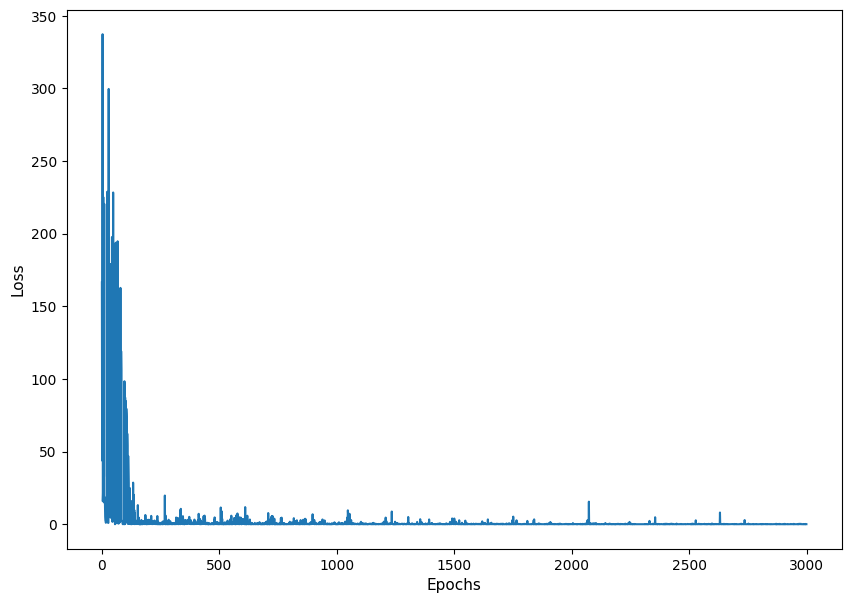

In [7]:
epochs = 3000
losses = [] #使用串列將每一次的loss記錄下來，方便之後將loss的變化趨勢畫成圖
for i in range(epochs):
  game = Gridworld(size=4, mode='static')
  state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0 #將3階的狀態陣列（4x4x4）轉換成向量（長度為64），並將每個值都加上一些雜訊（很小的數值）。	
  state1 = torch.from_numpy(state_).float().to(device) #將NumPy陣列轉換成PyTorch張量，並存於state1中
  status = 1 #用來追蹤遊戲是否仍在繼續（『1』代表仍在繼續）
  while(status == 1):
    qval = model(state1) #執行Q網路，取得所有動作的預測Q值
    qval_ = qval.cpu().data.numpy() #將qval轉換成NumPy陣列
    if (random.random() < epsilon): 
      action_ = np.random.randint(0,4) #隨機選擇一個動作（探索）
    else:
      action_ = np.argmax(qval_) #選擇Q值最大的動作（探索）        
    action = action_set[action_] #將代表某動作的數字對應到makeMove()的英文字母
    game.makeMove(action) #執行之前ε—貪婪策略所選出的動作 
    state2_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
    state2 = torch.from_numpy(state2_).float().to(device) #動作執行完畢，取得遊戲的新狀態並轉換成張量
    reward = game.reward()
    with torch.no_grad(): 
      newQ = model(state2.reshape(1,64))
    maxQ = torch.max(newQ) #將新狀態下所輸出的Q值向量中的最大值給記錄下來
    if reward == -1:
      Y = reward + (gamma * maxQ)  #計算訓練所用的目標Q值
    else: #若reward不等於-1，代表遊戲已經結束，也就沒有下一個狀態了，因此目標Q值就等於回饋值
      Y = reward
    Y = torch.tensor([Y], dtype=torch.float32).detach().to(device)
    X = qval.squeeze()[action_] #將演算法對執行的動作所預測的Q值存進X，並使用squeeze()將qval中維度為1的階去掉 (shape[1,4]會變成[4])
    loss = loss_fn(X, Y) #計算目標Q值與預測Q值之間的誤差
    if i%100 == 0:
      print(i, loss.item())
      clear_output(wait=True)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    state1 = state2
    if abs(reward) == 10:       
      status = 0 # 若 reward 的絕對值為10，代表遊戲已經分出勝負，所以設status為0  
  losses.append(loss.item())
  if epsilon > 0.1: 
    epsilon -= (1/epochs) #讓ε的值隨著訓練的進行而慢慢下降，直到0.1（還是要保留探索的動作）
plt.figure(figsize=(10,7))
plt.plot(losses)
plt.xlabel("Epochs",fontsize=11)
plt.ylabel("Loss",fontsize=11)

In [8]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W

In [9]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' 'P']]
Move #: 0; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' 'P' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']]
Move #: 2; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W

In [10]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[[' ' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[[' ' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[[' ' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[['P' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: d
[[' ' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['P' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: d
[[' ' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['P' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 7; Taking action: d
[[' ' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 8; Taking action: u
[['P' ' ' 'W' ' ']
 ['-' '+' ' ' ' ']
 [

<span style="font-size: 24px;">Basic DQN for player mode</span>

Text(0, 0.5, 'Loss')

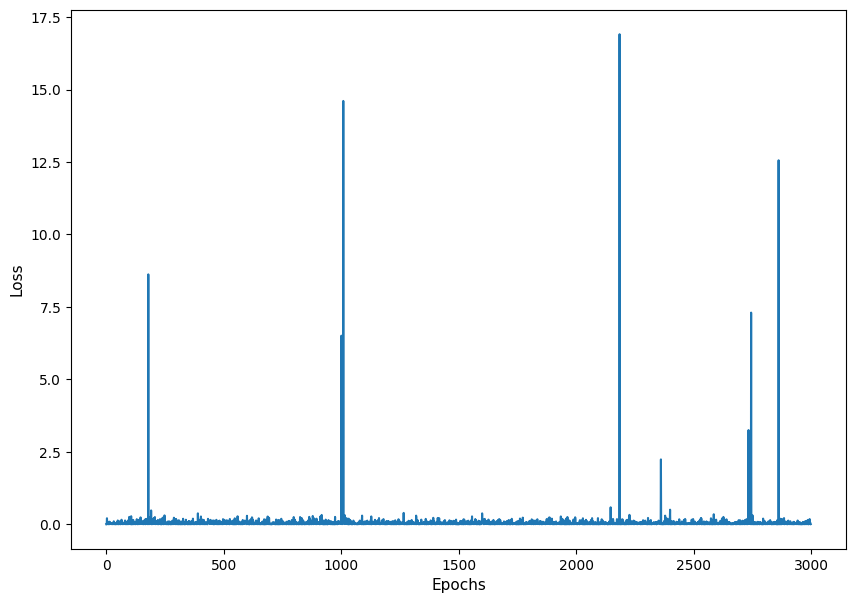

In [11]:
epochs = 3000
losses = [] #使用串列將每一次的loss記錄下來，方便之後將loss的變化趨勢畫成圖
for i in range(epochs):
  game = Gridworld(size=4, mode='player')
  state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0 #將3階的狀態陣列（4x4x4）轉換成向量（長度為64），並將每個值都加上一些雜訊（很小的數值）。	
  state1 = torch.from_numpy(state_).float().to(device) #將NumPy陣列轉換成PyTorch張量，並存於state1中
  status = 1 #用來追蹤遊戲是否仍在繼續（『1』代表仍在繼續）
  while(status == 1):
    qval = model(state1) #執行Q網路，取得所有動作的預測Q值
    qval_ = qval.cpu().data.numpy() #將qval轉換成NumPy陣列
    if (random.random() < epsilon): 
      action_ = np.random.randint(0,4) #隨機選擇一個動作（探索）
    else:
      action_ = np.argmax(qval_) #選擇Q值最大的動作（探索）        
    action = action_set[action_] #將代表某動作的數字對應到makeMove()的英文字母
    game.makeMove(action) #執行之前ε—貪婪策略所選出的動作 
    state2_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
    state2 = torch.from_numpy(state2_).float().to(device) #動作執行完畢，取得遊戲的新狀態並轉換成張量
    reward = game.reward()
    with torch.no_grad(): 
      newQ = model(state2.reshape(1,64))
    maxQ = torch.max(newQ) #將新狀態下所輸出的Q值向量中的最大值給記錄下來
    if reward == -1:
      Y = reward + (gamma * maxQ)  #計算訓練所用的目標Q值
    else: #若reward不等於-1，代表遊戲已經結束，也就沒有下一個狀態了，因此目標Q值就等於回饋值
      Y = reward
    Y = torch.tensor([Y], dtype=torch.float32).detach().to(device)
    X = qval.squeeze()[action_] #將演算法對執行的動作所預測的Q值存進X，並使用squeeze()將qval中維度為1的階去掉 (shape[1,4]會變成[4])
    loss = loss_fn(X, Y) #計算目標Q值與預測Q值之間的誤差
    if i%100 == 0:
      print(i, loss.item())
      clear_output(wait=True)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    state1 = state2
    if abs(reward) == 10:       
      status = 0 # 若 reward 的絕對值為10，代表遊戲已經分出勝負，所以設status為0  
  losses.append(loss.item())
  if epsilon > 0.1: 
    epsilon -= (1/epochs) #讓ε的值隨著訓練的進行而慢慢下降，直到0.1（還是要保留探索的動作）
plt.figure(figsize=(10,7))
plt.plot(losses)
plt.xlabel("Epochs",fontsize=11)
plt.ylabel("Loss",fontsize=11)

In [12]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W

In [13]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W

In [14]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 0; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 1; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 2; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 3; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 4; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 5; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 6; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 7; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 8; Taking action: d
[[' ' ' ' 'P' ' ']
 [' ' '-' 'W' ' ']
 [

<span style="font-size: 24px;">Basic DQN for random mode</span>

Text(0, 0.5, 'Loss')

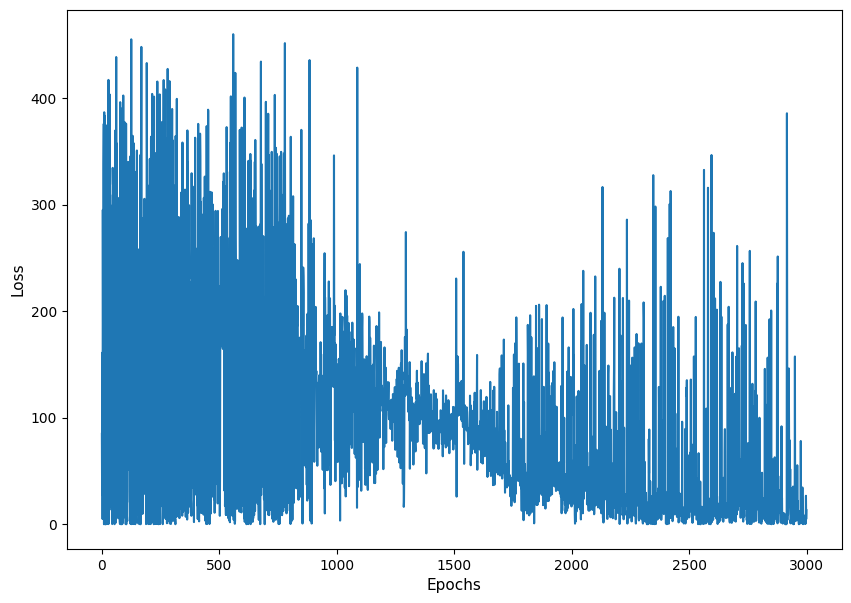

In [15]:
epochs = 3000
losses = [] #使用串列將每一次的loss記錄下來，方便之後將loss的變化趨勢畫成圖
for i in range(epochs):
  game = Gridworld(size=4, mode='random')
  state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0 #將3階的狀態陣列（4x4x4）轉換成向量（長度為64），並將每個值都加上一些雜訊（很小的數值）。	
  state1 = torch.from_numpy(state_).float().to(device) #將NumPy陣列轉換成PyTorch張量，並存於state1中
  status = 1 #用來追蹤遊戲是否仍在繼續（『1』代表仍在繼續）
  while(status == 1):
    qval = model(state1) #執行Q網路，取得所有動作的預測Q值
    qval_ = qval.cpu().data.numpy() #將qval轉換成NumPy陣列
    if (random.random() < epsilon): 
      action_ = np.random.randint(0,4) #隨機選擇一個動作（探索）
    else:
      action_ = np.argmax(qval_) #選擇Q值最大的動作（探索）        
    action = action_set[action_] #將代表某動作的數字對應到makeMove()的英文字母
    game.makeMove(action) #執行之前ε—貪婪策略所選出的動作 
    state2_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
    state2 = torch.from_numpy(state2_).float().to(device) #動作執行完畢，取得遊戲的新狀態並轉換成張量
    reward = game.reward()
    with torch.no_grad(): 
      newQ = model(state2.reshape(1,64))
    maxQ = torch.max(newQ) #將新狀態下所輸出的Q值向量中的最大值給記錄下來
    if reward == -1:
      Y = reward + (gamma * maxQ)  #計算訓練所用的目標Q值
    else: #若reward不等於-1，代表遊戲已經結束，也就沒有下一個狀態了，因此目標Q值就等於回饋值
      Y = reward
    Y = torch.tensor([Y], dtype=torch.float32).detach().to(device)
    X = qval.squeeze()[action_] #將演算法對執行的動作所預測的Q值存進X，並使用squeeze()將qval中維度為1的階去掉 (shape[1,4]會變成[4])
    loss = loss_fn(X, Y) #計算目標Q值與預測Q值之間的誤差
    if i%100 == 0:
      print(i, loss.item())
      clear_output(wait=True)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    state1 = state2
    if abs(reward) == 10:       
      status = 0 # 若 reward 的絕對值為10，代表遊戲已經分出勝負，所以設status為0  
  losses.append(loss.item())
  if epsilon > 0.1: 
    epsilon -= (1/epochs) #讓ε的值隨著訓練的進行而慢慢下降，直到0.1（還是要保留探索的動作）
plt.figure(figsize=(10,7))
plt.plot(losses)
plt.xlabel("Epochs",fontsize=11)
plt.ylabel("Loss",fontsize=11)

In [16]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' 

In [17]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W

In [18]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[[' ' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']]
Move #: 0; Taking action: r
[[' ' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']]
Move #: 1; Taking action: u
[[' ' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' 'W' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[[' ' ' ' ' ' '+']
 [' ' '-' 'P' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[[' ' ' ' 'P' '+']
 [' ' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: r
[[' ' ' ' ' ' '+']
 [' ' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[[' ' '-' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' 'W' ' ' ' ']]
Move #: 0; Taking action: d
[[' ' '-' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' '+']
 [' ' 'W' ' ' ' ']]
Move #: 1; Taking action: d
[[' ' '-' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' 'W' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[[' ' ' ' '-' 

<span style="font-size: 36px;">Double DQN</span>

<span style="font-size: 24px;">Double DQN for static mode</span>

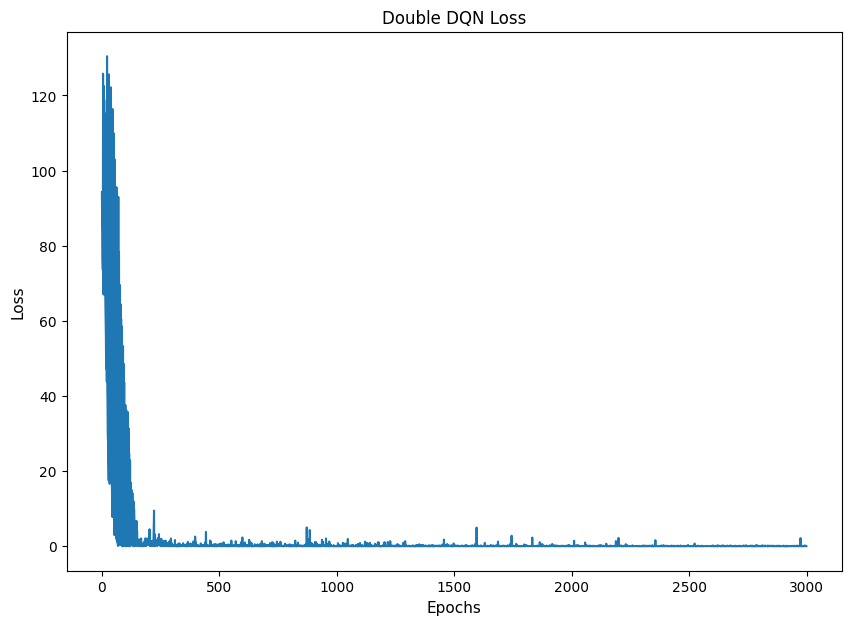

In [19]:
# 定義模型架構
class QNet(nn.Module):
    def __init__(self):
        super(QNet, self).__init__()
        self.fc1 = nn.Linear(64, 128)
        self.fc2 = nn.Linear(128, 4)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        return self.fc2(x)

# 初始化主網路與目標網路
model = QNet().to(device)
target_model = QNet().to(device)
target_model.load_state_dict(model.state_dict())  # 初始與 model 同權重
target_model.eval()  # 推論用，不需要計算梯度

loss_fn = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
gamma = 0.9
epsilon = 1.0

epochs = 3000
losses = []

# 每隔多少回合同步一次 target_model
sync_interval = 20

for i in range(epochs):
    game = Gridworld(size=4, mode='static')
    state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
    state1 = torch.from_numpy(state_).float().to(device)
    status = 1

    while status == 1:
        qval = model(state1)
        qval_ = qval.cpu().data.numpy()

        if random.random() < epsilon:
            action_ = np.random.randint(0, 4)
        else:
            action_ = np.argmax(qval_)

        action = action_set[action_]
        game.makeMove(action)
        state2_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
        state2 = torch.from_numpy(state2_).float().to(device)
        reward = game.reward()

        with torch.no_grad():
            # Double DQN 核心邏輯：
            # 主網路選動作
            next_qvals = model(state2)
            next_action = torch.argmax(next_qvals).item()
            # 目標網路估算該動作的 Q 值
            target_qvals = target_model(state2)
            maxQ = target_qvals[0][next_action]

        if reward == -1:
            Y = reward + gamma * maxQ
        else:
            Y = reward

        Y = torch.tensor([Y], dtype=torch.float32).to(device)
        X = qval[0][action_]
        loss = loss_fn(X, Y)

        if i % 100 == 0:
            print(f"Epoch {i}, Loss: {loss.item():.4f}")
            clear_output(wait=True)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        state1 = state2
        if abs(reward) == 10:
            status = 0

    losses.append(loss.item())

    # 更新 ε
    if epsilon > 0.1:
        epsilon -= (1/epochs)

    # 每隔 sync_interval 回合，同步一次 target_model
    if i % sync_interval == 0:
        target_model.load_state_dict(model.state_dict())

# 畫出 Loss 曲線
plt.figure(figsize=(10, 7))
plt.plot(losses)
plt.xlabel("Epochs", fontsize=11)
plt.ylabel("Loss", fontsize=11)
plt.title("Double DQN Loss")
plt.show()


In [20]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W

In [21]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' 'P' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W

In [22]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[[' ' ' ' ' ' 'W']
 [' ' ' ' ' ' ' ']
 [' ' 'P' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 0; Taking action: l
[[' ' ' ' ' ' 'W']
 [' ' ' ' ' ' ' ']
 ['P' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 1; Taking action: u
[[' ' ' ' ' ' 'W']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 2; Taking action: u
[['P' ' ' ' ' 'W']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 3; Taking action: d
[[' ' ' ' ' ' 'W']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 4; Taking action: u
[['P' ' ' ' ' 'W']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 5; Taking action: u
[['P' ' ' ' ' 'W']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 6; Taking action: d
[[' ' ' ' ' ' 'W']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 7; Taking action: u
[['P' ' ' ' ' 'W']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']
 [' ' ' ' ' ' '-']]
Move #: 8; Taking action: d
[[' ' ' ' ' ' 'W']
 ['P' ' ' ' ' ' ']
 [

<span style="font-size: 24px;">Double DQN for player mode</span>

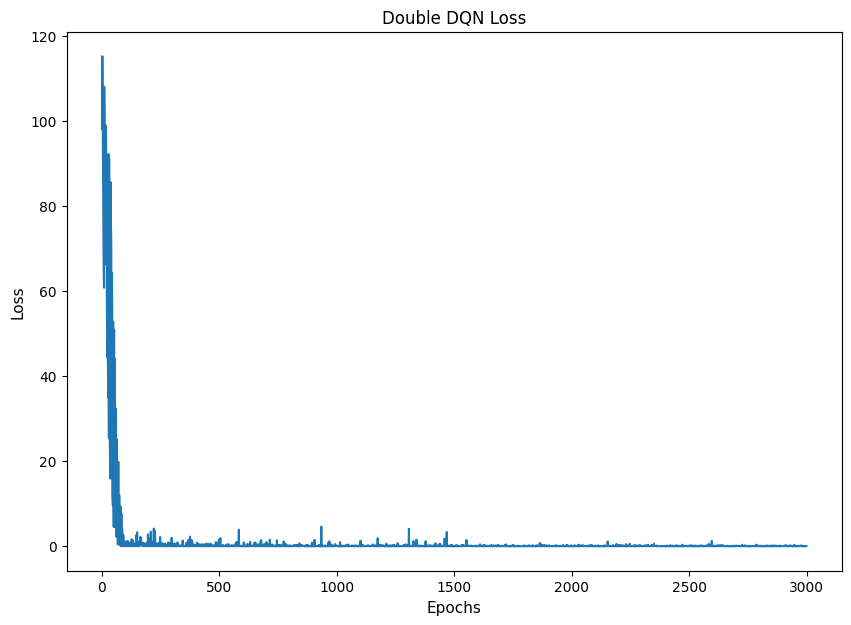

In [23]:
# 定義模型架構
class QNet(nn.Module):
    def __init__(self):
        super(QNet, self).__init__()
        self.fc1 = nn.Linear(64, 128)
        self.fc2 = nn.Linear(128, 4)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        return self.fc2(x)

# 初始化主網路與目標網路
model = QNet().to(device)
target_model = QNet().to(device)
target_model.load_state_dict(model.state_dict())  # 初始與 model 同權重
target_model.eval()  # 推論用，不需要計算梯度

loss_fn = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
gamma = 0.9
epsilon = 1.0

epochs = 3000
losses = []

# 每隔多少回合同步一次 target_model
sync_interval = 20

for i in range(epochs):
    game = Gridworld(size=4, mode='player')
    state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
    state1 = torch.from_numpy(state_).float().to(device)
    status = 1

    while status == 1:
        qval = model(state1)
        qval_ = qval.cpu().data.numpy()

        if random.random() < epsilon:
            action_ = np.random.randint(0, 4)
        else:
            action_ = np.argmax(qval_)

        action = action_set[action_]
        game.makeMove(action)
        state2_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
        state2 = torch.from_numpy(state2_).float().to(device)
        reward = game.reward()

        with torch.no_grad():
            # Double DQN 核心邏輯：
            # 主網路選動作
            next_qvals = model(state2)
            next_action = torch.argmax(next_qvals).item()
            # 目標網路估算該動作的 Q 值
            target_qvals = target_model(state2)
            maxQ = target_qvals[0][next_action]

        if reward == -1:
            Y = reward + gamma * maxQ
        else:
            Y = reward

        Y = torch.tensor([Y], dtype=torch.float32).to(device)
        X = qval[0][action_]
        loss = loss_fn(X, Y)

        if i % 100 == 0:
            print(f"Epoch {i}, Loss: {loss.item():.4f}")
            clear_output(wait=True)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        state1 = state2
        if abs(reward) == 10:
            status = 0

    losses.append(loss.item())

    # 更新 ε
    if epsilon > 0.1:
        epsilon -= (1/epochs)

    # 每隔 sync_interval 回合，同步一次 target_model
    if i % sync_interval == 0:
        target_model.load_state_dict(model.state_dict())

# 畫出 Loss 曲線
plt.figure(figsize=(10, 7))
plt.plot(losses)
plt.xlabel("Epochs", fontsize=11)
plt.ylabel("Loss", fontsize=11)
plt.title("Double DQN Loss")
plt.show()


In [24]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W

In [25]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 0; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W

In [26]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']]
Move #: 0; Taking action: l
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 7; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 ['W' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 8; Taking action: u
[[' ' ' ' ' ' '-']
 [' ' ' ' '+' ' ']
 [

<span style="font-size: 24px;">Double DQN for random mode</span>

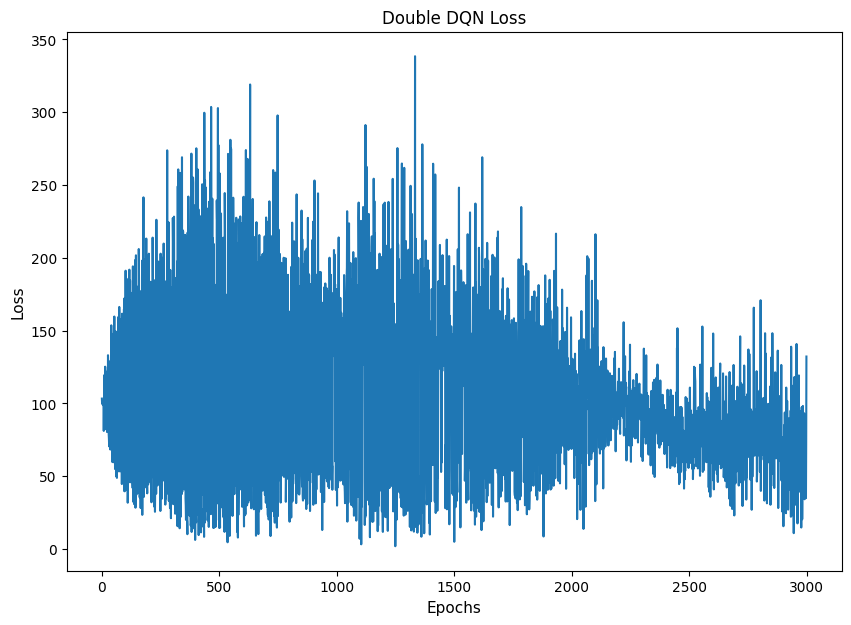

In [27]:
# 定義模型架構
class QNet(nn.Module):
    def __init__(self):
        super(QNet, self).__init__()
        self.fc1 = nn.Linear(64, 128)
        self.fc2 = nn.Linear(128, 4)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        return self.fc2(x)

# 初始化主網路與目標網路
model = QNet().to(device)
target_model = QNet().to(device)
target_model.load_state_dict(model.state_dict())  # 初始與 model 同權重
target_model.eval()  # 推論用，不需要計算梯度

loss_fn = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
gamma = 0.9 
epsilon = 1.0

epochs = 3000
losses = []

# 每隔多少回合同步一次 target_model
sync_interval = 20

for i in range(epochs):
    game = Gridworld(size=4, mode='random')
    state_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
    state1 = torch.from_numpy(state_).float().to(device)
    status = 1

    while status == 1:
        qval = model(state1)
        qval_ = qval.cpu().data.numpy()

        if random.random() < epsilon:
            action_ = np.random.randint(0, 4)
        else:
            action_ = np.argmax(qval_)

        action = action_set[action_]
        game.makeMove(action)
        state2_ = game.board.render_np().reshape(1,64) + np.random.rand(1,64)/10.0
        state2 = torch.from_numpy(state2_).float().to(device)
        reward = game.reward()

        with torch.no_grad():
            # Double DQN 核心邏輯：
            # 主網路選動作
            next_qvals = model(state2)
            next_action = torch.argmax(next_qvals).item()
            # 目標網路估算該動作的 Q 值
            target_qvals = target_model(state2)
            maxQ = target_qvals[0][next_action]

        if reward == -1:
            Y = reward + gamma * maxQ
        else:
            Y = reward

        Y = torch.tensor([Y], dtype=torch.float32).to(device)
        X = qval[0][action_]
        loss = loss_fn(X, Y)

        if i % 100 == 0:
            print(f"Epoch {i}, Loss: {loss.item():.4f}")
            clear_output(wait=True)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        state1 = state2
        if abs(reward) == 10:
            status = 0

    losses.append(loss.item())

    # 更新 ε
    if epsilon > 0.1:
        epsilon -= (1/epochs) 

    # 每隔 sync_interval 回合，同步一次 target_model
    if i % sync_interval == 0:
        target_model.load_state_dict(model.state_dict())

# 畫出 Loss 曲線
plt.figure(figsize=(10, 7))
plt.plot(losses)
plt.xlabel("Epochs", fontsize=11)
plt.ylabel("Loss", fontsize=11)
plt.title("Double DQN Loss")
plt.show()


In [28]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 7; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 8; Taking action: u
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [

In [29]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']]
Move #: 0; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 7; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 8; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [

In [30]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[[' ' ' ' '-' ' ']
 ['W' ' ' 'P' ' ']
 [' ' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[[' ' ' ' '-' ' ']
 ['W' 'P' ' ' ' ']
 [' ' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: d
[[' ' ' ' '-' ' ']
 ['W' ' ' ' ' ' ']
 [' ' '+' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[[' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '-' '+' ' ']]
Move #: 0; Taking action: l
[[' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '-' '+' ' ']]
Move #: 1; Taking action: l
[[' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '-' '+' ' ']]
Move #: 2; Taking action: d
[[' ' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '-' '+' ' ']]
Move #: 3; Taking action: l
[[' ' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '-' '+' ' ']]
Move #: 4; Taking action: r
[[' ' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['W' '-' '+' ' ']]
Move #: 5; Taking action: d
[[' ' ' ' ' ' ' ']
 [' ' ' 

<span style="font-size: 36px;">Dueling DQN</span>

<span style="font-size: 24px;">Dueling DQN for static mode</span>

Text(0, 0.5, 'Loss')

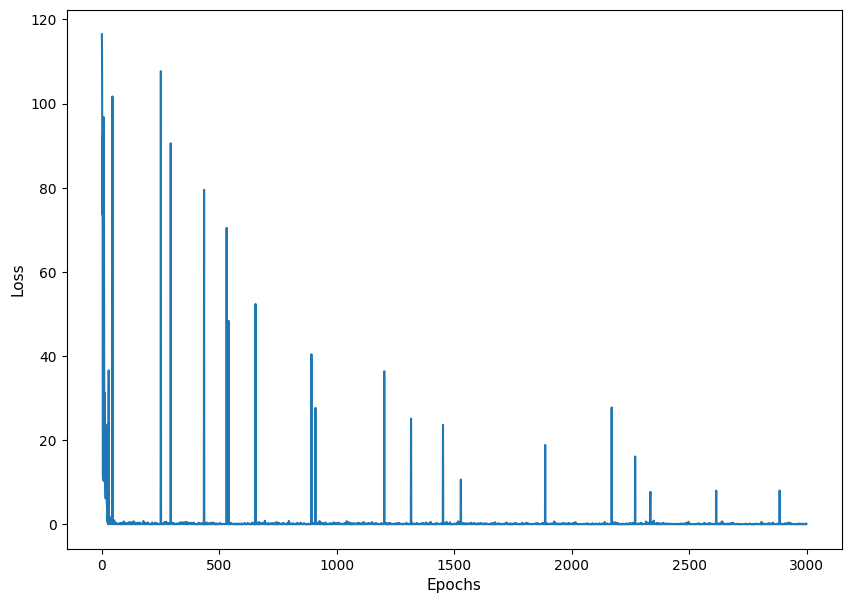

In [31]:
epochs = 3000
losses = []  # 使用串列將每一次的loss記錄下來，方便之後將loss的變化趨勢畫成圖
for i in range(epochs):
    game = Gridworld(size=4, mode='static')
    state_ = game.board.render_np().reshape(1, 64) + np.random.rand(1, 64) / 10.0
    state1 = torch.from_numpy(state_).float().to(device)  # 將NumPy陣列轉換成PyTorch張量，並存於state1中
    status = 1  # 用來追蹤遊戲是否仍在繼續（『1』代表仍在繼續）
    while status == 1:
        qval = model(state1)  # 執行Q網路，取得所有動作的預測Q值
        qval_ = qval.cpu().data.numpy()  # 將qval轉換成NumPy陣列
        if random.random() < epsilon:
            action_ = np.random.randint(0, 4)  # 隨機選擇一個動作（探索）
        else:
            action_ = np.argmax(qval_)  # 選擇Q值最大的動作（探索）
        action = action_set[action_]  # 將代表某動作的數字對應到makeMove()的英文字母
        game.makeMove(action)  # 執行之前ε—貪婪策略所選出的動作
        state2_ = game.board.render_np().reshape(1, 64) + np.random.rand(1, 64) / 10.0
        state2 = torch.from_numpy(state2_).float().to(device)  # 動作執行完畢，取得遊戲的新狀態並轉換成張量
        reward = game.reward()
        with torch.no_grad():
            newQ = model(state2.reshape(1, 64))
        maxQ = torch.max(newQ)  # 將新狀態下所輸出的Q值向量中的最大值給記錄下來
        if reward == -1:
            Y = reward + (gamma * maxQ)  # 計算訓練所用的目標Q值
        else:  # 若reward不等於-1，代表遊戲已經結束，也就沒有下一個狀態了，因此目標Q值就等於回饋值
            Y = reward
        Y = torch.Tensor([Y]).detach()
        Y = Y.to(device)
        X = qval.squeeze()[action_].to(device)  # 將演算法對執行的動作所預測的Q值存進X，並使用squeeze()將qval中維度為1的階去掉 (shape[1,4]會變成[4])
        loss = loss_fn(X, Y)  # 計算目標Q值與預測Q值之間的誤差
        if i % 100 == 0:
            print(i, loss.item())
            clear_output(wait=True)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        state1 = state2
        if abs(reward) == 10:
            status = 0  # 若 reward 的絕對值為10，代表遊戲已經分出勝負，所以設status為0
    losses.append(loss.item())
    if epsilon > 0.1:
        epsilon -= (1 / epochs)  # 讓ε的值隨著訓練的進行而慢慢下降，直到0.1（還是要保留探索的動作）

plt.figure(figsize=(10, 7))
plt.plot(losses)
plt.xlabel("Epochs", fontsize=11)
plt.ylabel("Loss", fontsize=11)


In [32]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' 'W

In [33]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 0; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 

In [34]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 [' ' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']]
Move #: 0; Taking action: u
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: l
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: l
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 7; Taking action: r
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 8; Taking action: l
[[' ' ' ' '+' ' ']
 [' ' '-' 'W' ' ']
 [

<span style="font-size: 24px;">Dueling DQN for player mode</span>

Text(0, 0.5, 'Loss')

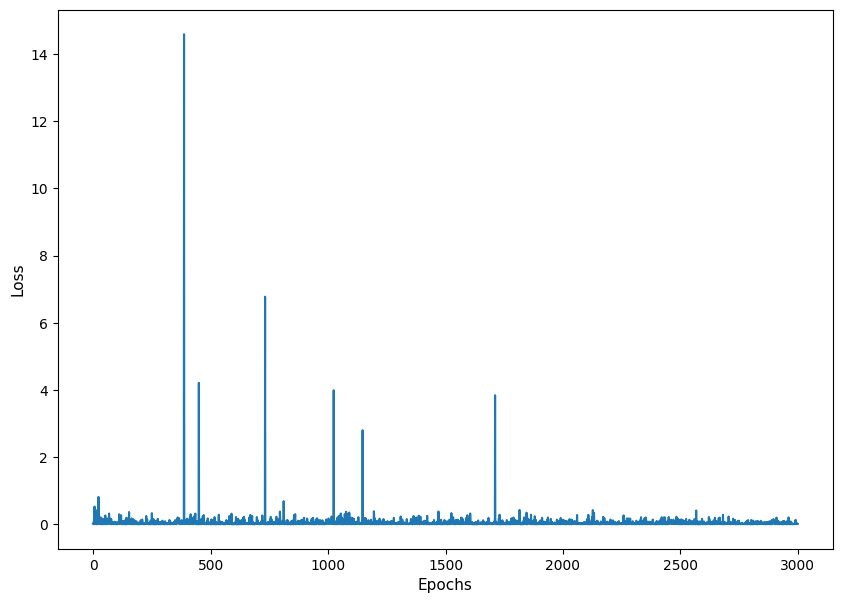

In [35]:
epochs = 3000
losses = []  # 使用串列將每一次的loss記錄下來，方便之後將loss的變化趨勢畫成圖
for i in range(epochs):
    game = Gridworld(size=4, mode='player')
    state_ = game.board.render_np().reshape(1, 64) + np.random.rand(1, 64) / 10.0
    state1 = torch.from_numpy(state_).float().to(device)  # 將NumPy陣列轉換成PyTorch張量，並存於state1中
    status = 1  # 用來追蹤遊戲是否仍在繼續（『1』代表仍在繼續）
    while status == 1:
        qval = model(state1)  # 執行Q網路，取得所有動作的預測Q值
        qval_ = qval.cpu().data.numpy()  # 將qval轉換成NumPy陣列
        if random.random() < epsilon:
            action_ = np.random.randint(0, 4)  # 隨機選擇一個動作（探索）
        else:
            action_ = np.argmax(qval_)  # 選擇Q值最大的動作（探索）
        action = action_set[action_]  # 將代表某動作的數字對應到makeMove()的英文字母
        game.makeMove(action)  # 執行之前ε—貪婪策略所選出的動作
        state2_ = game.board.render_np().reshape(1, 64) + np.random.rand(1, 64) / 10.0
        state2 = torch.from_numpy(state2_).float().to(device)  # 動作執行完畢，取得遊戲的新狀態並轉換成張量
        reward = game.reward()
        with torch.no_grad():
            newQ = model(state2.reshape(1, 64))
        maxQ = torch.max(newQ)  # 將新狀態下所輸出的Q值向量中的最大值給記錄下來
        if reward == -1:
            Y = reward + (gamma * maxQ)  # 計算訓練所用的目標Q值
        else:  # 若reward不等於-1，代表遊戲已經結束，也就沒有下一個狀態了，因此目標Q值就等於回饋值
            Y = reward
        Y = torch.Tensor([Y]).detach()
        Y = Y.to(device)
        X = qval.squeeze()[action_].to(device)  # 將演算法對執行的動作所預測的Q值存進X，並使用squeeze()將qval中維度為1的階去掉 (shape[1,4]會變成[4])
        loss = loss_fn(X, Y)  # 計算目標Q值與預測Q值之間的誤差
        if i % 100 == 0:
            print(i, loss.item())
            clear_output(wait=True)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        state1 = state2
        if abs(reward) == 10:
            status = 0  # 若 reward 的絕對值為10，代表遊戲已經分出勝負，所以設status為0
    losses.append(loss.item())
    if epsilon > 0.1:
        epsilon -= (1 / epochs)  # 讓ε的值隨著訓練的進行而慢慢下降，直到0.1（還是要保留探索的動作）

plt.figure(figsize=(10, 7))
plt.plot(losses)
plt.xlabel("Epochs", fontsize=11)
plt.ylabel("Loss", fontsize=11)


In [36]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 5; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 6; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' 'W

In [37]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' 'P']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' 'P' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: d
[['+' '-' ' ' ' ']
 [' ' 'W

In [38]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['-' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' '+' ' ']
 [' ' ' ' ' ' 'W']]
Move #: 0; Taking action: r
[['-' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' '+' ' ']
 [' ' ' ' ' ' 'W']]
Move #: 1; Taking action: r
[['-' ' ' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' '+' ' ']
 [' ' ' ' ' ' 'W']]
Move #: 2; Taking action: d
[['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '+' ' ']
 [' ' ' ' ' ' 'W']]
Game won! Reward: 10
True
Initial State:
[[' ' ' ' ' ' 'P']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '+' 'W']]
Move #: 0; Taking action: r
[[' ' ' ' ' ' 'P']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '+' 'W']]
Move #: 1; Taking action: r
[[' ' ' ' ' ' 'P']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '+' 'W']]
Move #: 2; Taking action: r
[[' ' ' ' ' ' 'P']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '+' 'W']]
Move #: 3; Taking action: r
[[' ' ' ' ' ' 'P']
 ['-' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '+' 'W']]
Move #: 4; Taking action: r
[[' ' ' ' ' ' 'P']
 ['-' ' 

<span style="font-size: 24px;">Dueling DQN for random mode</span>

Text(0, 0.5, 'Loss')

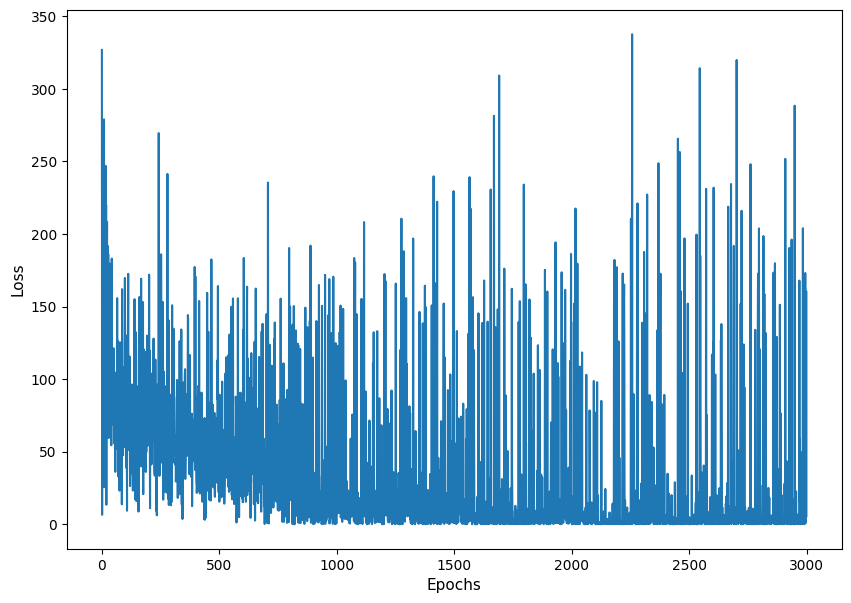

In [39]:
epochs = 3000
losses = []  # 使用串列將每一次的loss記錄下來，方便之後將loss的變化趨勢畫成圖
for i in range(epochs):
    game = Gridworld(size=4, mode='random')
    state_ = game.board.render_np().reshape(1, 64) + np.random.rand(1, 64) / 10.0
    state1 = torch.from_numpy(state_).float().to(device)  # 將NumPy陣列轉換成PyTorch張量，並存於state1中
    status = 1  # 用來追蹤遊戲是否仍在繼續（『1』代表仍在繼續）
    while status == 1:
        qval = model(state1)  # 執行Q網路，取得所有動作的預測Q值
        qval_ = qval.cpu().data.numpy()  # 將qval轉換成NumPy陣列
        if random.random() < epsilon:
            action_ = np.random.randint(0, 4)  # 隨機選擇一個動作（探索）
        else:
            action_ = np.argmax(qval_)  # 選擇Q值最大的動作（探索）
        action = action_set[action_]  # 將代表某動作的數字對應到makeMove()的英文字母
        game.makeMove(action)  # 執行之前ε—貪婪策略所選出的動作
        state2_ = game.board.render_np().reshape(1, 64) + np.random.rand(1, 64) / 10.0
        state2 = torch.from_numpy(state2_).float().to(device)  # 動作執行完畢，取得遊戲的新狀態並轉換成張量
        reward = game.reward()
        with torch.no_grad():
            newQ = model(state2.reshape(1, 64))
        maxQ = torch.max(newQ)  # 將新狀態下所輸出的Q值向量中的最大值給記錄下來
        if reward == -1:
            Y = reward + (gamma * maxQ)  # 計算訓練所用的目標Q值
        else:  # 若reward不等於-1，代表遊戲已經結束，也就沒有下一個狀態了，因此目標Q值就等於回饋值
            Y = reward
        Y = torch.Tensor([Y]).detach()
        Y = Y.to(device)
        X = qval.squeeze()[action_].to(device)  # 將演算法對執行的動作所預測的Q值存進X，並使用squeeze()將qval中維度為1的階去掉 (shape[1,4]會變成[4])
        loss = loss_fn(X, Y)  # 計算目標Q值與預測Q值之間的誤差
        if i % 100 == 0:
            print(i, loss.item())
            clear_output(wait=True)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        state1 = state2
        if abs(reward) == 10:
            status = 0  # 若 reward 的絕對值為10，代表遊戲已經分出勝負，所以設status為0
    losses.append(loss.item())
    if epsilon > 0.1:
        epsilon -= (1 / epochs)  # 讓ε的值隨著訓練的進行而慢慢下降，直到0.1（還是要保留探索的動作）

plt.figure(figsize=(10, 7))
plt.plot(losses)
plt.xlabel("Epochs", fontsize=11)
plt.ylabel("Loss", fontsize=11)


In [40]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='static') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' 'P']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' 'P' 

In [41]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='player') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' 'P']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 1; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 2; Taking action: l
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 3; Taking action: u
[['+' '-' ' ' ' ']
 ['P' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 4; Taking action: u
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']]
Game won! Reward: 10
True
Initial State:
[['+' '-' ' ' ' ']
 [' ' 'W' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' ' ' ' ']]
Move #: 0; Taking action: l
[['+' '-' ' ' 

In [42]:
max_games = 1000 #模擬5000次遊戲
wins = 0
for i in range(max_games):
  win = test_model(model, mode='random') #模式測試
  if win:
    wins += 1
win_perc = float(wins) / float(max_games)
print("Games played: {0}, # of wins: {1}".format(max_games,wins))
print("Win percentage: {}%".format(100.0*win_perc)) #顯示勝率

Initial State:
[['+' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' 'P' ' ']
 [' ' ' ' '-' ' ']]
Move #: 0; Taking action: l
[['+' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' 'P' ' ' ' ']
 [' ' ' ' '-' ' ']]
Move #: 1; Taking action: l
[['+' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' '-' ' ']]
Move #: 2; Taking action: u
[['+' ' ' 'W' ' ']
 ['P' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '-' ' ']]
Move #: 3; Taking action: u
[['+' ' ' 'W' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' ' ']
 [' ' ' ' '-' ' ']]
Game won! Reward: 10
True
Initial State:
[[' ' 'P' ' ' ' ']
 [' ' 'W' ' ' '-']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 0; Taking action: r
[[' ' ' ' 'P' ' ']
 [' ' 'W' ' ' '-']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 1; Taking action: r
[[' ' ' ' ' ' 'P']
 [' ' 'W' ' ' '-']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 2; Taking action: d
[[' ' ' ' ' ' ' ']
 [' ' 'W' ' ' '-']
 [' ' ' ' ' ' ' ']
 [' ' ' ' ' ' '+']]
Move #: 3; Taking action: d
[[' ' ' ' ' ' ' ']
 [' ' 'W